In [20]:
import numpy as np
import pandas as pd
import math
import seaborn as sns
import xgboost as xgb


In [21]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import tensorflow as tf
import tensorflow_addons as tfa


from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import LabelEncoder
from sklearn.svm import SVR
from plotly.subplots import make_subplots
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import acf, pacf
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_absolute_error
from keras import Sequential
from keras import layers
from keras.models import Model
from keras.layers import LSTM, BatchNormalization, Dropout, Dense, Flatten, Conv1D
from keras.layers import MaxPooling1D, GRU, Input,Masking, Concatenate, dot
from keras.optimizers import Adam, SGD
from keras.losses import MeanAbsoluteError
from keras.metrics import RootMeanSquaredError
from keras.callbacks import EarlyStopping
from keras.callbacks import LearningRateScheduler

In [129]:
df_energy1= pd.read_excel('Dataset_HourlyE.xlsx')

In [354]:
df_energy = df_energy1

In [355]:
df_energy[:10].head()

,time,Feat 1,Feat 2,Feat 3,Feat 4,Feat 5,Feat 6,Feat 7,Feat 8,Feat 9,Feat 10,Feat 11,Feat 12,Feat 13,Feat 14,Feat 15,Feat 16,Feat 17,Feat 18,Feat 19,Feat 20,Feat 21,Feat 22,Feat 23,Feat 24,Feat 25,Feat 26,Feat 27,Feat 28,Feat 29,Feat 30,Feat 31,Feat 32,Feat 33,Feat 34,Feat 35,Feat 36,Feat 37,Feat 38,Feat 39,Feat 40,Feat 41,Feat 42,Feat 43,Feat 44,Feat 45,Feat 46,Feat 47,Feat 48,Feat 49,Feat 50,Feat 51,Feat 52,Feat 53,Feat 54,Feat 55,Feat 56,Feat 57,Feat 58,Feat 59,Feat 60,Feat 61,Feat 62,Feat 63,Feat 64,Feat 65,Feat 66,Feat 67,Feat 68,Feat 69,Feat 70,Feat 71,Feat 72,Feat 73,Feat 74,Feat 75,Target
0,2015-01-01 00:00:00,17.01,7.67,14.67,7.16,6.33,14.59,14.95,8.09,14.73,14.70,6.26,16.04,7.28,11.83,7.28,16.39,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31,22.50,17.13,11.72,16.13,11.70,10.92,19.42,18.99,30.77,25.68,27.11,52.20,7.64,2.88,7.60,3.79,15.66,20.23,22.08,30.19,0.69,-18.74,1177.0,1504.0,617.0,912.0,938.0,2145.0,604.0,296.0,4954.0,489.0,1598.0,15234.0,8178.0,1014.0,128.0,0,33.0,-205.0,3238.0,1938.0,5423.0,0.0,3566.0,421.0,313.0,24.68
1,2015-01-01 01:00:00,67.11,-15.25,42.65,-16.14,-25.31,42.00,41.76,-13.63,43.07,42.58,-25.05,56.35,-12.19,20.76,-13.20,24.68,16.39,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31,22.50,17.13,11.72,16.13,11.70,10.92,19.42,18.99,30.77,35.75,24.92,11.34,29.27,1.10,10.84,4.47,21.67,2.24,25.35,0.63,-14.52,1098.0,1417.0,604.0,862.0,894.0,1997.0,566.0,280.0,4752.0,488.0,1528.0,14486.0,7692.0,965.0,130.0,0,36.0,-188.0,2860.0,1390.0,5423.0,0.0,3578.0,397.0,310.0,63.18
2,2015-01-01 02:00:00,71.15,0.54,50.97,-0.88,-8.37,50.40,50.75,2.48,51.33,50.99,-8.31,62.35,2.02,31.62,1.26,63.18,24.68,16.39,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31,22.50,17.13,11.72,16.13,11.70,10.92,19.42,18.99,27.14,26.88,9.23,17.73,1.10,9.63,3.36,11.45,2.22,21.12,0.61,-11.05,1035.0,1354.0,579.0,825.0,830.0,1884.0,552.0,273.0,4541.0,482.0,1481.0,13836.0,7335.0,935.0,127.0,0,38.0,-63.0,2721.0,1251.0,5423.0,0.0,2340.0,449.0,310.0,66.96
3,2015-01-01 03:00:00,286.20,8.53,206.96,2.49,-27.06,204.83,206.61,17.17,208.39,207.09,-27.08,251.66,13.61,130.60,10.72,66.96,63.18,24.68,16.39,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31,22.50,17.13,11.72,16.13,11.70,10.92,19.42,26.22,16.53,11.31,2.91,1.08,0.00,2.20,0.00,2.21,21.07,0.63,-10.70,1015.0,1338.0,559.0,807.0,806.0,1811.0,548.0,257.0,4377.0,487.0,1456.0,13461.0,7185.0,919.0,129.0,0,29.0,-68.0,2713.0,1193.0,5422.0,0.0,2238.0,442.0,311.0,21.42
4,2015-01-01 04:00:00,17.53,0.98,12.82,0.61,-1.13,12.70,12.80,1.56,12.91,12.83,-1.12,15.49,1.25,8.26,1.08,21.42,66.96,63.18,24.68,16.39,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31,22.50,17.13,11.72,16.13,11.70,10.92,24.66,9.31,-26.07,3.51,1.08,-26.33,-27.45,9.15,-10.48,22.44,0.57,-13.19,992.0,1353.0,544.0,805.0,798.0,1759.0,545.0,251.0,4274.0,484.0,1438.0,13243.0,7175.0,922.0,126.0,0,33.0,-68.0,2127.0,1192.0,5423.0,0.0,1905.0,466.0,305.0,21.47


In [356]:
df_energy.iloc[0:10, :10]

,time,Feat 1,Feat 2,Feat 3,Feat 4,Feat 5,Feat 6,Feat 7,Feat 8,Feat 9
0,2015-01-01 00:00:00,17.01,7.67,14.67,7.16,6.33,14.59,14.95,8.09,14.73
1,2015-01-01 01:00:00,67.11,-15.25,42.65,-16.14,-25.31,42.00,41.76,-13.63,43.07
2,2015-01-01 02:00:00,71.15,0.54,50.97,-0.88,-8.37,50.40,50.75,2.48,51.33
3,2015-01-01 03:00:00,286.20,8.53,206.96,2.49,-27.06,204.83,206.61,17.17,208.39
4,2015-01-01 04:00:00,17.53,0.98,12.82,0.61,-1.13,12.70,12.80,1.56,12.91
5,2015-01-01 05:00:00,17.53,0.99,12.82,0.61,-1.13,12.71,12.81,1.57,12.91
6,2015-01-01 06:00:00,1.13,1.07,1.15,1.04,1.04,1.15,1.18,1.09,1.15
7,2015-01-01 07:00:00,1.20,1.08,1.20,1.04,1.05,1.20,1.24,1.11,1.21
8,2015-01-01 08:00:00,20.47,0.92,14.87,0.50,-1.59,14.74,14.83,1.50,14.97
9,2015-01-01 09:00:00,1.17,1.11,1.20,1.06,1.08,1.20,1.23,1.14,1.20


In [357]:
df_energy.iloc[0:10, 10:20]

,Feat 10,Feat 11,Feat 12,Feat 13,Feat 14,Feat 15,Feat 16,Feat 17,Feat 18,Feat 19
0,14.70,6.26,16.04,7.28,11.83,7.28,16.39,17.09,21.21,17.16
1,42.58,-25.05,56.35,-12.19,20.76,-13.20,24.68,16.39,17.09,21.21
2,50.99,-8.31,62.35,2.02,31.62,1.26,63.18,24.68,16.39,17.09
3,207.09,-27.08,251.66,13.61,130.60,10.72,66.96,63.18,24.68,16.39
4,12.83,-1.12,15.49,1.25,8.26,1.08,21.42,66.96,63.18,24.68
5,12.83,-1.12,15.49,1.25,8.26,1.09,21.47,21.42,66.96,63.18
6,1.15,1.03,1.14,1.01,1.10,1.03,0.00,21.47,21.42,66.96
7,1.21,1.04,11.90,1.02,1.14,1.03,1.14,0.00,21.47,21.42
8,14.87,-1.58,19.02,1.28,9.49,1.09,1.16,1.14,0.00,21.47
9,1.20,1.07,8.58,1.02,1.14,1.03,0.01,1.16,1.14,0.00


In [358]:
df_energy.iloc[0:10, 20:35]

,Feat 20,Feat 21,Feat 22,Feat 23,Feat 24,Feat 25,Feat 26,Feat 27,Feat 28,Feat 29,Feat 30,Feat 31,Feat 32,Feat 33,Feat 34
0,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31,22.50,17.13,11.72,16.13,11.70,10.92
1,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31,22.50,17.13,11.72,16.13,11.70
2,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31,22.50,17.13,11.72,16.13
3,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31,22.50,17.13,11.72
4,16.39,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31,22.50,17.13
5,24.68,16.39,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31,22.50
6,63.18,24.68,16.39,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36,20.31
7,66.96,63.18,24.68,16.39,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26,20.36
8,21.42,66.96,63.18,24.68,16.39,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24,20.26
9,21.47,21.42,66.96,63.18,24.68,16.39,17.09,21.21,17.16,55.43,29.93,18.64,14.09,20.82,22.24


In [359]:
df_energy.iloc[0:10, 35:50]

,Feat 35,Feat 36,Feat 37,Feat 38,Feat 39,Feat 40,Feat 41,Feat 42,Feat 43,Feat 44,Feat 45,Feat 46,Feat 47,Feat 48,Feat 49
0,19.42,18.99,30.77,25.68,27.11,52.20,7.64,2.88,7.60,3.79,15.66,20.23,22.08,30.19,0.69
1,10.92,19.42,18.99,30.77,35.75,24.92,11.34,29.27,1.10,10.84,4.47,21.67,2.24,25.35,0.63
2,11.70,10.92,19.42,18.99,27.14,26.88,9.23,17.73,1.10,9.63,3.36,11.45,2.22,21.12,0.61
3,16.13,11.70,10.92,19.42,26.22,16.53,11.31,2.91,1.08,0.00,2.20,0.00,2.21,21.07,0.63
4,11.72,16.13,11.70,10.92,24.66,9.31,-26.07,3.51,1.08,-26.33,-27.45,9.15,-10.48,22.44,0.57
5,17.13,11.72,16.13,11.70,12.06,6.94,0.01,-22.93,2.16,0.00,-29.84,0.01,0.00,25.48,0.58
6,22.50,17.13,11.72,16.13,14.23,23.11,9.27,6.80,2.22,0.00,3.50,22.00,32.42,26.65,0.48
7,20.31,22.50,17.13,11.72,21.99,24.12,9.28,11.69,2.22,0.00,15.17,37.02,25.21,28.89,0.39
8,20.36,20.31,22.50,17.13,22.83,24.03,11.43,13.73,5.80,0.01,11.38,29.11,26.98,25.91,0.66
9,20.26,20.36,20.31,22.50,19.25,56.27,10.47,16.55,1.16,6.96,17.80,23.54,20.90,30.88,0.57


In [360]:
df_energy.iloc[0:10, 50:65]

,Feat 50,Feat 51,Feat 52,Feat 53,Feat 54,Feat 55,Feat 56,Feat 57,Feat 58,Feat 59,Feat 60,Feat 61,Feat 62,Feat 63,Feat 64
0,-18.74,1177.0,1504.0,617.0,912.0,938.0,2145.0,604.0,296.0,4954.0,489.0,1598.0,15234.0,8178.0,1014.0
1,-14.52,1098.0,1417.0,604.0,862.0,894.0,1997.0,566.0,280.0,4752.0,488.0,1528.0,14486.0,7692.0,965.0
2,-11.05,1035.0,1354.0,579.0,825.0,830.0,1884.0,552.0,273.0,4541.0,482.0,1481.0,13836.0,7335.0,935.0
3,-10.70,1015.0,1338.0,559.0,807.0,806.0,1811.0,548.0,257.0,4377.0,487.0,1456.0,13461.0,7185.0,919.0
4,-13.19,992.0,1353.0,544.0,805.0,798.0,1759.0,545.0,251.0,4274.0,484.0,1438.0,13243.0,7175.0,922.0
5,-15.90,1029.0,1357.0,550.0,818.0,823.0,1759.0,552.0,259.0,4280.0,497.0,1450.0,13374.0,7415.0,958.0
6,-18.34,1041.0,1382.0,557.0,832.0,837.0,1784.0,574.0,256.0,4357.0,499.0,1463.0,13582.0,7778.0,1015.0
7,-22.07,1056.0,1414.0,548.0,849.0,839.0,1769.0,585.0,248.0,4424.0,494.0,1472.0,13698.0,8071.0,1059.0
8,-15.34,1100.0,1449.0,552.0,874.0,877.0,1790.0,626.0,256.0,4542.0,506.0,1469.0,14041.0,8467.0,1110.0
9,-21.73,1172.0,1563.0,579.0,893.0,942.0,1878.0,683.0,267.0,4714.0,515.0,1583.0,14789.0,8833.0,1151.0


In [361]:
df_energy.iloc[0:10, 65:77]

,Feat 65,Feat 66,Feat 67,Feat 68,Feat 69,Feat 70,Feat 71,Feat 72,Feat 73,Feat 74,Feat 75,Target
0,128.0,0,33.0,-205.0,3238.0,1938.0,5423.0,0.0,3566.0,421.0,313.0,24.68
1,130.0,0,36.0,-188.0,2860.0,1390.0,5423.0,0.0,3578.0,397.0,310.0,63.18
2,127.0,0,38.0,-63.0,2721.0,1251.0,5423.0,0.0,2340.0,449.0,310.0,66.96
3,129.0,0,29.0,-68.0,2713.0,1193.0,5422.0,0.0,2238.0,442.0,311.0,21.42
4,126.0,0,33.0,-68.0,2127.0,1192.0,5423.0,0.0,1905.0,466.0,305.0,21.47
5,130.0,0,25.0,-88.0,2200.0,1195.0,5422.0,0.0,1917.0,435.0,309.0,0.00
6,127.0,0,25.0,-89.0,2368.0,1215.0,5423.0,0.0,2031.0,406.0,308.0,1.14
7,129.0,0,25.0,-97.0,2559.0,1281.0,5422.0,32.0,2010.0,462.0,305.0,1.16
8,127.0,0,0.0,-101.0,3015.0,1364.0,5422.0,70.0,2579.0,368.0,304.0,0.01
9,130.0,0,2.0,-116.0,2865.0,1457.0,5424.0,86.0,2735.0,392.0,310.0,1.15


In [362]:
pd.set_option('display.max_rows', None)  # Display all rows
pd.set_option('display.max_columns', None)  # Display all columns

df_energy.describe().T

,count,mean,min,25%,50%,75%,max,std
time,70128,2018-12-31 23:30:00,2015-01-01 00:00:00,2016-12-31 11:45:00,2018-12-31 23:30:00,2020-12-31 11:15:00,2022-12-31 23:00:00,NaN
Feat 1,70128.0,39.998379,-811.37,19.82,27.24,41.19,4954.71,64.608166
Feat 2,70128.0,28.710666,-1603.12,15.2475,22.195,32.11,4311.09,45.395504
Feat 3,70128.0,37.754453,-208.97,19.83,27.0,40.16,4596.72,54.216589
Feat 4,70128.0,27.556219,-1719.89,14.56,21.37,30.9925,4020.8,43.469923
Feat 5,70128.0,23.430041,-3607.09,12.38,19.98,29.09,2301.29,54.523274
Feat 6,70128.0,37.008495,-358.03,19.55,26.72,39.58,4555.1,52.795203
Feat 7,70128.0,44.984444,-2162.06,21.24,30.035,47.62,4659.3,69.053292
Feat 8,70128.0,29.070211,-1631.96,15.36,22.46,32.59,4404.94,46.540237
Feat 9,70128.0,37.74493,-207.83,19.7875,26.98,40.09,4592.68,54.362087


In [363]:
df_energy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70128 entries, 0 to 70127
Data columns (total 77 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   time     70128 non-null  datetime64[ns]
 1   Feat 1   70128 non-null  float64       
 2   Feat 2   70128 non-null  float64       
 3   Feat 3   70128 non-null  float64       
 4   Feat 4   70128 non-null  float64       
 5   Feat 5   70128 non-null  float64       
 6   Feat 6   70128 non-null  float64       
 7   Feat 7   70128 non-null  float64       
 8   Feat 8   70128 non-null  float64       
 9   Feat 9   70128 non-null  float64       
 10  Feat 10  70128 non-null  float64       
 11  Feat 11  70128 non-null  float64       
 12  Feat 12  70128 non-null  float64       
 13  Feat 13  70128 non-null  float64       
 14  Feat 14  70128 non-null  float64       
 15  Feat 15  70128 non-null  float64       
 16  Feat 16  70128 non-null  float64       
 17  Feat 17  70128 non-null  float6

In [364]:
columns_to_drop = [f'Feat {i}' for i in range(16, 48)]

# Drop the columns from the DataFrame
df_energy = df_energy.drop(columns=columns_to_drop)

# Display the updated DataFrame
print(df_energy.head())

                 time  Feat 1  Feat 2  Feat 3  Feat 4  Feat 5  Feat 6  Feat 7  \
0 2015-01-01 00:00:00   17.01    7.67   14.67    7.16    6.33   14.59   14.95   
1 2015-01-01 01:00:00   67.11  -15.25   42.65  -16.14  -25.31   42.00   41.76   
2 2015-01-01 02:00:00   71.15    0.54   50.97   -0.88   -8.37   50.40   50.75   
3 2015-01-01 03:00:00  286.20    8.53  206.96    2.49  -27.06  204.83  206.61   
4 2015-01-01 04:00:00   17.53    0.98   12.82    0.61   -1.13   12.70   12.80   

   Feat 8  Feat 9  Feat 10  Feat 11  Feat 12  Feat 13  Feat 14  Feat 15  \
0    8.09   14.73    14.70     6.26    16.04     7.28    11.83     7.28   
1  -13.63   43.07    42.58   -25.05    56.35   -12.19    20.76   -13.20   
2    2.48   51.33    50.99    -8.31    62.35     2.02    31.62     1.26   
3   17.17  208.39   207.09   -27.08   251.66    13.61   130.60    10.72   
4    1.56   12.91    12.83    -1.12    15.49     1.25     8.26     1.08   

   Feat 48  Feat 49  Feat 50  Feat 51  Feat 52  Feat 53  Feat 

In [365]:
df_energy.describe().T

,count,mean,min,25%,50%,75%,max,std
time,70128,2018-12-31 23:30:00,2015-01-01 00:00:00,2016-12-31 11:45:00,2018-12-31 23:30:00,2020-12-31 11:15:00,2022-12-31 23:00:00,NaN
Feat 1,70128.0,39.998379,-811.37,19.82,27.24,41.19,4954.71,64.608166
Feat 2,70128.0,28.710666,-1603.12,15.2475,22.195,32.11,4311.09,45.395504
Feat 3,70128.0,37.754453,-208.97,19.83,27.0,40.16,4596.72,54.216589
Feat 4,70128.0,27.556219,-1719.89,14.56,21.37,30.9925,4020.8,43.469923
Feat 5,70128.0,23.430041,-3607.09,12.38,19.98,29.09,2301.29,54.523274
Feat 6,70128.0,37.008495,-358.03,19.55,26.72,39.58,4555.1,52.795203
Feat 7,70128.0,44.984444,-2162.06,21.24,30.035,47.62,4659.3,69.053292
Feat 8,70128.0,29.070211,-1631.96,15.36,22.46,32.59,4404.94,46.540237
Feat 9,70128.0,37.74493,-207.83,19.7875,26.98,40.09,4592.68,54.362087


In [366]:
df_energy = df_energy.drop('Feat 66', axis = 1)

In [367]:
# Checking Nans and duplicates in each columns
def check_Nans_Dups(df_input):
    
    print('Number of Nans in each column :')
    
    print(df_input.isnull().sum())
    print()
    print(f'Number of duplicates in the dataframe : {df_input.duplicated().sum()}')
    return

In [368]:
check_Nans_Dups(df_energy)


Number of Nans in each column :
time       0
Feat 1     0
Feat 2     0
Feat 3     0
Feat 4     0
Feat 5     0
Feat 6     0
Feat 7     0
Feat 8     0
Feat 9     0
Feat 10    0
Feat 11    0
Feat 12    0
Feat 13    0
Feat 14    0
Feat 15    0
Feat 48    0
Feat 49    0
Feat 50    0
Feat 51    0
Feat 52    0
Feat 53    0
Feat 54    0
Feat 55    0
Feat 56    0
Feat 57    0
Feat 58    0
Feat 59    0
Feat 60    0
Feat 61    0
Feat 62    0
Feat 63    0
Feat 64    0
Feat 65    0
Feat 67    0
Feat 68    0
Feat 69    0
Feat 70    0
Feat 71    0
Feat 72    0
Feat 73    0
Feat 74    0
Feat 75    0
Target     0
dtype: int64

Number of duplicates in the dataframe : 0


In [369]:
df_energy['time'] = pd.to_datetime(df_energy['time'])


In [370]:
df_energy = df_energy.set_index('time')

In [371]:
df_energy.shape

(70128, 43)

In [372]:
df_energy.head()

,Feat 1,Feat 2,Feat 3,Feat 4,Feat 5,Feat 6,Feat 7,Feat 8,Feat 9,Feat 10,Feat 11,Feat 12,Feat 13,Feat 14,Feat 15,Feat 48,Feat 49,Feat 50,Feat 51,Feat 52,Feat 53,Feat 54,Feat 55,Feat 56,Feat 57,Feat 58,Feat 59,Feat 60,Feat 61,Feat 62,Feat 63,Feat 64,Feat 65,Feat 67,Feat 68,Feat 69,Feat 70,Feat 71,Feat 72,Feat 73,Feat 74,Feat 75,Target
time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2015-01-01 00:00:00,17.01,7.67,14.67,7.16,6.33,14.59,14.95,8.09,14.73,14.70,6.26,16.04,7.28,11.83,7.28,30.19,0.69,-18.74,1177.0,1504.0,617.0,912.0,938.0,2145.0,604.0,296.0,4954.0,489.0,1598.0,15234.0,8178.0,1014.0,128.0,33.0,-205.0,3238.0,1938.0,5423.0,0.0,3566.0,421.0,313.0,24.68
2015-01-01 01:00:00,67.11,-15.25,42.65,-16.14,-25.31,42.00,41.76,-13.63,43.07,42.58,-25.05,56.35,-12.19,20.76,-13.20,25.35,0.63,-14.52,1098.0,1417.0,604.0,862.0,894.0,1997.0,566.0,280.0,4752.0,488.0,1528.0,14486.0,7692.0,965.0,130.0,36.0,-188.0,2860.0,1390.0,5423.0,0.0,3578.0,397.0,310.0,63.18
2015-01-01 02:00:00,71.15,0.54,50.97,-0.88,-8.37,50.40,50.75,2.48,51.33,50.99,-8.31,62.35,2.02,31.62,1.26,21.12,0.61,-11.05,1035.0,1354.0,579.0,825.0,830.0,1884.0,552.0,273.0,4541.0,482.0,1481.0,13836.0,7335.0,935.0,127.0,38.0,-63.0,2721.0,1251.0,5423.0,0.0,2340.0,449.0,310.0,66.96
2015-01-01 03:00:00,286.20,8.53,206.96,2.49,-27.06,204.83,206.61,17.17,208.39,207.09,-27.08,251.66,13.61,130.60,10.72,21.07,0.63,-10.70,1015.0,1338.0,559.0,807.0,806.0,1811.0,548.0,257.0,4377.0,487.0,1456.0,13461.0,7185.0,919.0,129.0,29.0,-68.0,2713.0,1193.0,5422.0,0.0,2238.0,442.0,311.0,21.42
2015-01-01 04:00:00,17.53,0.98,12.82,0.61,-1.13,12.70,12.80,1.56,12.91,12.83,-1.12,15.49,1.25,8.26,1.08,22.44,0.57,-13.19,992.0,1353.0,544.0,805.0,798.0,1759.0,545.0,251.0,4274.0,484.0,1438.0,13243.0,7175.0,922.0,126.0,33.0,-68.0,2127.0,1192.0,5423.0,0.0,1905.0,466.0,305.0,21.47


Text(0, 0.5, 'Price')

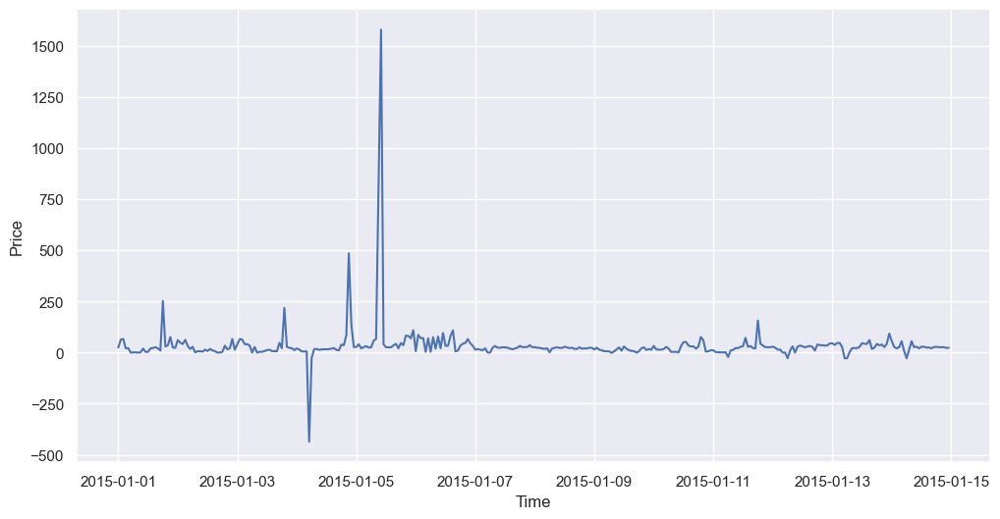

In [373]:
plt.figure(figsize=(12,6))
# plot total load actual for two weeks duration 
plt.plot(df_energy['Target'][:24*7*2])
plt.xlabel('Time')
plt.ylabel('Price')

In [374]:
df_energy[df_energy.isna().any(axis = 1)]

,Feat 1,Feat 2,Feat 3,Feat 4,Feat 5,Feat 6,Feat 7,Feat 8,Feat 9,Feat 10,Feat 11,Feat 12,Feat 13,Feat 14,Feat 15,Feat 48,Feat 49,Feat 50,Feat 51,Feat 52,Feat 53,Feat 54,Feat 55,Feat 56,Feat 57,Feat 58,Feat 59,Feat 60,Feat 61,Feat 62,Feat 63,Feat 64,Feat 65,Feat 67,Feat 68,Feat 69,Feat 70,Feat 71,Feat 72,Feat 73,Feat 74,Feat 75,Target
time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,


In [375]:
df_energy.isnull().sum()


Feat 1     0
Feat 2     0
Feat 3     0
Feat 4     0
Feat 5     0
Feat 6     0
Feat 7     0
Feat 8     0
Feat 9     0
Feat 10    0
Feat 11    0
Feat 12    0
Feat 13    0
Feat 14    0
Feat 15    0
Feat 48    0
Feat 49    0
Feat 50    0
Feat 51    0
Feat 52    0
Feat 53    0
Feat 54    0
Feat 55    0
Feat 56    0
Feat 57    0
Feat 58    0
Feat 59    0
Feat 60    0
Feat 61    0
Feat 62    0
Feat 63    0
Feat 64    0
Feat 65    0
Feat 67    0
Feat 68    0
Feat 69    0
Feat 70    0
Feat 71    0
Feat 72    0
Feat 73    0
Feat 74    0
Feat 75    0
Target     0
dtype: int64

In [376]:
def feat_corr(input_df):
    corr = input_df.corr()
    plt.figure(figsize=(20,20))
    #plot heat map
    g=sns.heatmap(corr,annot=True,cmap="RdYlGn", vmin=-1, vmax=1)
    plt.title('Feature Correlation')
    
    return plt.show()

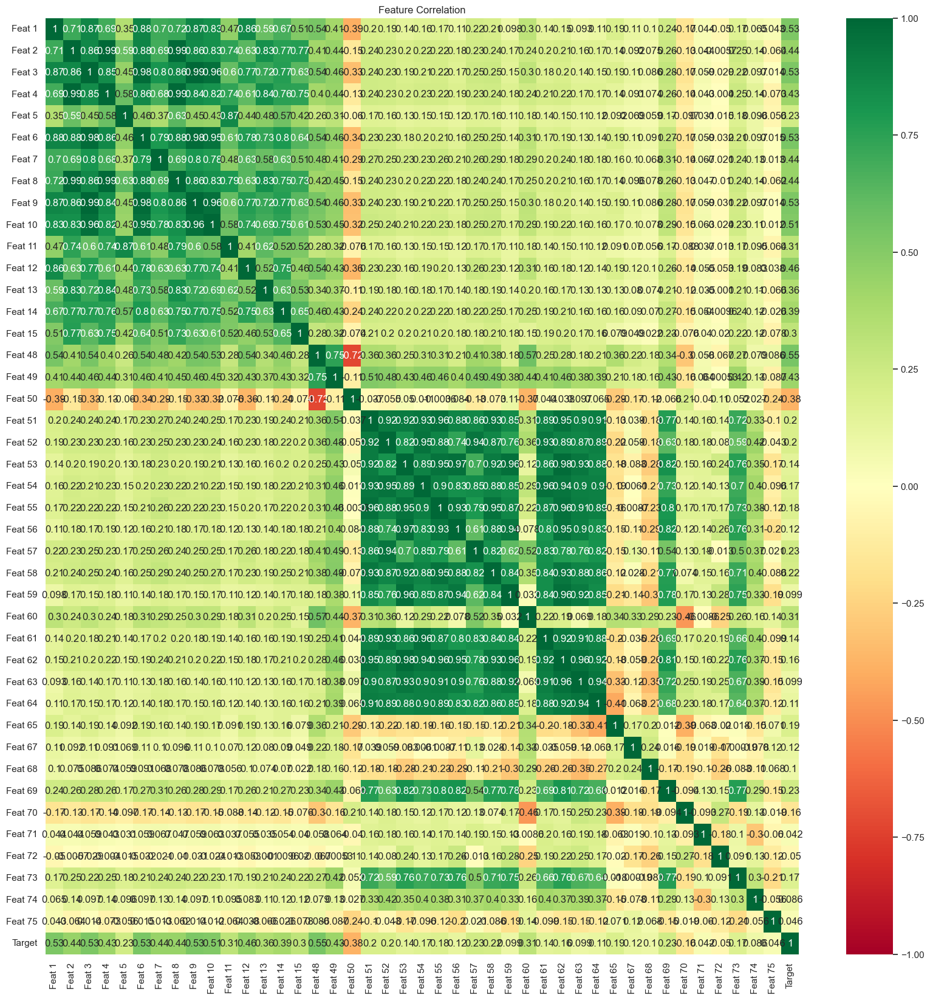

In [377]:
feat_corr(df_energy)


In [378]:
correlation_matrix = df_energy.corr()

# Define a threshold for high correlation
threshold = 0.9

# Find the pairs of features with correlation above the threshold
high_corr_pairs = (
    correlation_matrix
    .where((correlation_matrix.abs() > threshold) & (correlation_matrix.abs() < 1))  # Exclude self-correlation
    .stack()  # Convert the matrix to a Series
    .reset_index()  # Convert to DataFrame for better visualization
)

# Rename columns for clarity
high_corr_pairs.columns = ['Feature 1', 'Feature 2', 'Correlation']

# Sort by absolute correlation value
high_corr_pairs = high_corr_pairs.sort_values(by='Correlation', ascending=False)

# Display the highly correlated features
print(high_corr_pairs)

   Feature 1 Feature 2  Correlation
12    Feat 9    Feat 3     0.994748
3     Feat 3    Feat 9     0.994748
0     Feat 2    Feat 4     0.993633
5     Feat 4    Feat 2     0.993633
10    Feat 8    Feat 2     0.990963
1     Feat 2    Feat 8     0.990963
6     Feat 4    Feat 8     0.986961
11    Feat 8    Feat 4     0.986961
7     Feat 6    Feat 3     0.982532
2     Feat 3    Feat 6     0.982532
34   Feat 53   Feat 62     0.982346
68   Feat 62   Feat 53     0.982346
8     Feat 6    Feat 9     0.981240
13    Feat 9    Feat 6     0.981240
49   Feat 56   Feat 53     0.965156
31   Feat 53   Feat 56     0.965156
59   Feat 59   Feat 53     0.964217
33   Feat 53   Feat 59     0.964217
4     Feat 3   Feat 10     0.961850
15   Feat 10    Feat 3     0.961850
61   Feat 59   Feat 62     0.961533
73   Feat 62   Feat 59     0.961533
70   Feat 62   Feat 55     0.959561
47   Feat 55   Feat 62     0.959561
42   Feat 55   Feat 51     0.959363
21   Feat 51   Feat 55     0.959363
14    Feat 9   Feat 10     0

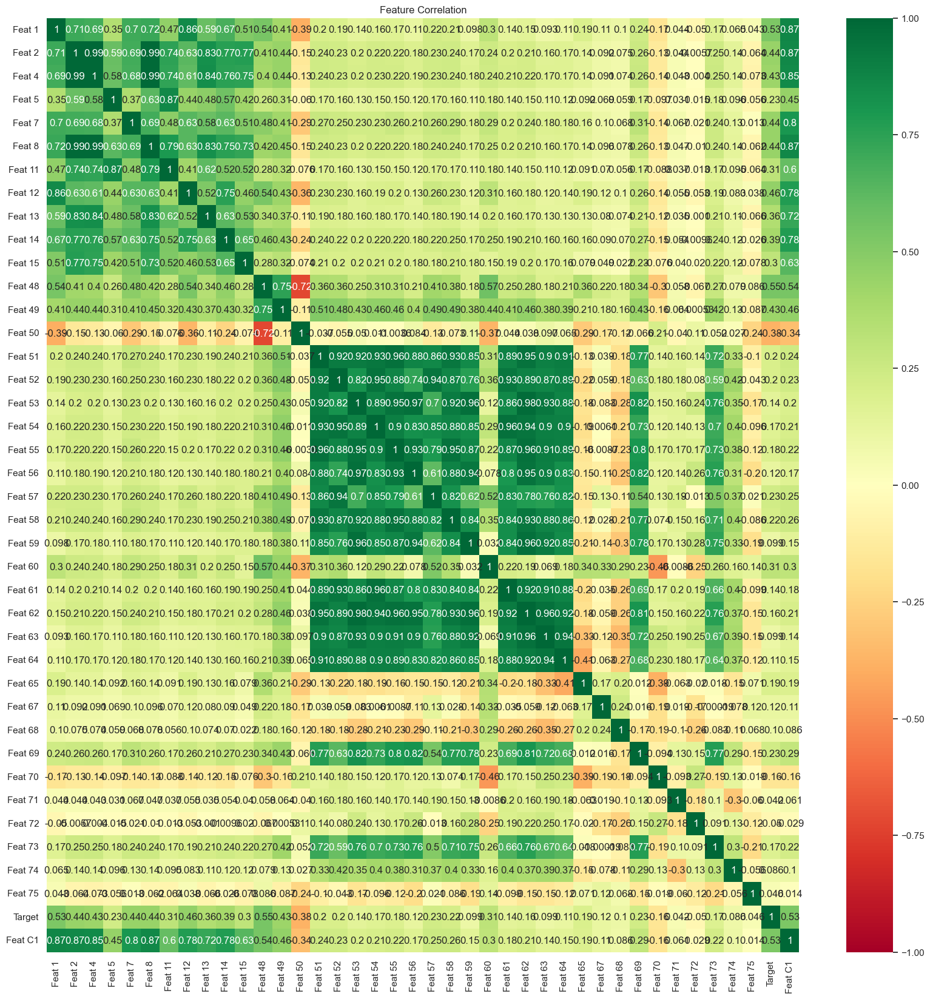

In [379]:
df_energy["Feat C1"] = df_energy['Feat 9'] + df_energy['Feat 3'] + df_energy['Feat 6'] + df_energy['Feat 10']
df_energy.drop(['Feat 9', 'Feat 3', 'Feat 6','Feat 10'], axis = 1, inplace = True)
feat_corr(df_energy)

In [380]:
df_energy.shape

(70128, 40)

In [381]:
df_energy["Feat C2"] = df_energy['Feat 51'] + df_energy['Feat 52'] + df_energy['Feat 53'] + df_energy['Feat 54'] +df_energy['Feat 55'] + df_energy['Feat 56'] + df_energy['Feat 57'] + df_energy['Feat 58']+df_energy['Feat 59'] + df_energy['Feat 61'] + df_energy['Feat 62'] + df_energy['Feat 63']+ df_energy['Feat 64']
df_energy.drop(['Feat 51', 'Feat 52', 'Feat 53','Feat 54','Feat 55', 'Feat 56', 'Feat 57','Feat 58','Feat 59', 'Feat 61', 'Feat 62','Feat 63','Feat 64'], axis = 1, inplace = True)
df_energy.shape

(70128, 28)

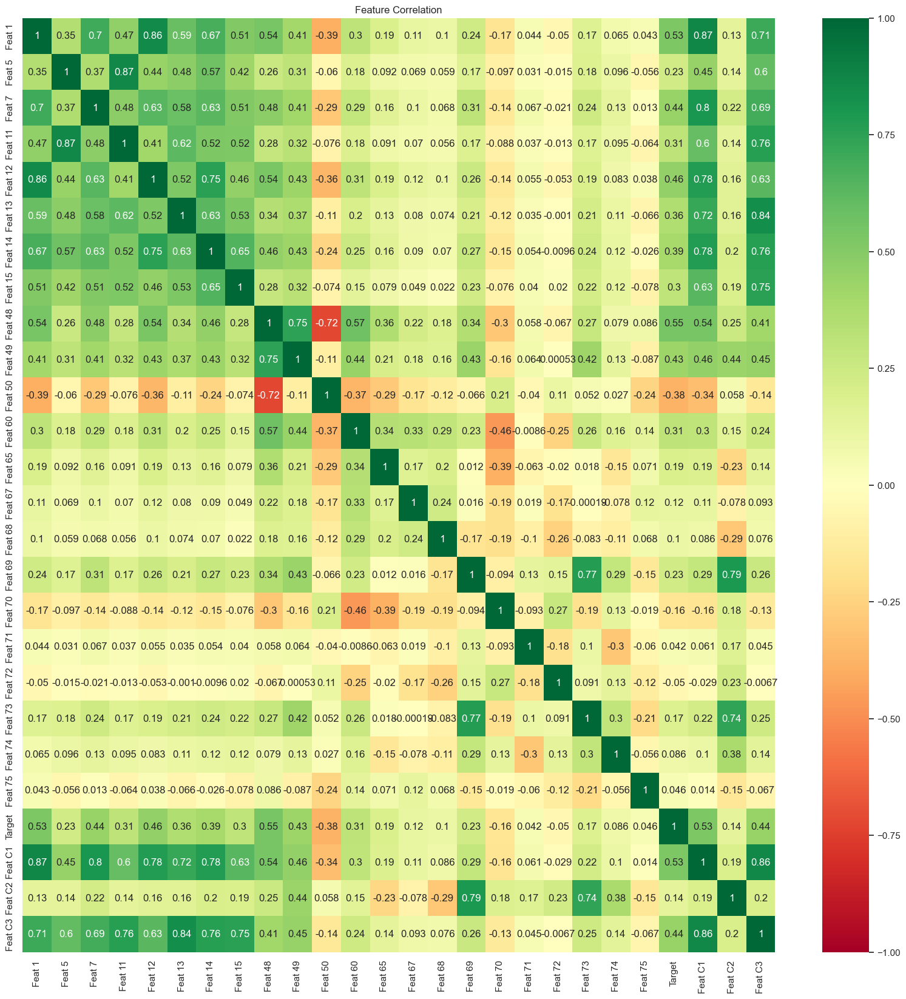

In [382]:
df_energy["Feat C3"] = df_energy['Feat 2'] + df_energy['Feat 4'] + df_energy['Feat 8'] 
df_energy.drop(['Feat 2', 'Feat 4', 'Feat 8'], axis = 1, inplace = True)
feat_corr(df_energy)

In [383]:
correlation_matrix = df_energy.corr()

# Define a threshold for high correlation
threshold = 0.76

# Find the pairs of features with correlation above the threshold
high_corr_pairs = (
    correlation_matrix
    .where((correlation_matrix.abs() > threshold) & (correlation_matrix.abs() < 1))  # Exclude self-correlation
    .stack()  # Convert the matrix to a Series
    .reset_index()  # Convert to DataFrame for better visualization
)

# Rename columns for clarity
high_corr_pairs.columns = ['Feature 1', 'Feature 2', 'Correlation']

# Sort by absolute correlation value
high_corr_pairs = high_corr_pairs.sort_values(by='Correlation', ascending=False)

# Display the highly correlated features
print(high_corr_pairs)

   Feature 1 Feature 2  Correlation
1     Feat 1   Feat C1     0.872571
13   Feat C1    Feat 1     0.872571
2     Feat 5   Feat 11     0.865695
4    Feat 11    Feat 5     0.865695
21   Feat C3   Feat C1     0.864284
17   Feat C1   Feat C3     0.864284
0     Feat 1   Feat 12     0.855004
5    Feat 12    Feat 1     0.855004
7    Feat 13   Feat C3     0.837600
19   Feat C3   Feat 13     0.837600
14   Feat C1    Feat 7     0.802619
3     Feat 7   Feat C1     0.802619
18   Feat C2   Feat 69     0.789786
11   Feat 69   Feat C2     0.789786
8    Feat 14   Feat C1     0.780845
16   Feat C1   Feat 14     0.780845
6    Feat 12   Feat C1     0.775274
15   Feat C1   Feat 12     0.775274
10   Feat 69   Feat 73     0.769735
12   Feat 73   Feat 69     0.769735
9    Feat 14   Feat C3     0.761290
20   Feat C3   Feat 14     0.761290


In [384]:
df_energy["Feat C13"] = df_energy['Feat C1'] + df_energy['Feat 1'] + df_energy['Feat C3'] + df_energy['Feat 12'] + df_energy['Feat 13'] + df_energy['Feat 7'] + df_energy['Feat 14'] 
df_energy.drop(['Feat C1', 'Feat 1', 'Feat 12','Feat 13','Feat C3', 'Feat 7', 'Feat 14'], axis = 1, inplace = True)
df_energy.shape

(70128, 20)

In [385]:
df_energy["Feat C4"] = df_energy['Feat 5'] + df_energy['Feat 11'] 
df_energy.drop(['Feat 5', 'Feat 11'], axis = 1, inplace = True)
df_energy.shape

(70128, 19)

In [386]:
df_energy["Feat C5"] = df_energy['Feat 69'] + df_energy['Feat 73'] + df_energy['Feat C2'] 
df_energy.drop(['Feat 69', 'Feat 73', 'Feat C2'], axis = 1, inplace = True)
df_energy.shape

(70128, 17)

In [387]:
df_energy["Feat C6"] = df_energy['Feat 48'] + df_energy['Feat 49'] 
df_energy.drop(['Feat 48', 'Feat 49'], axis = 1, inplace = True)
df_energy.shape

(70128, 16)

In [388]:
correlation_matrix = df_energy.corr()

# Define a threshold for high correlation
threshold = 0.70

# Find the pairs of features with correlation above the threshold
high_corr_pairs = (
    correlation_matrix
    .where((correlation_matrix.abs() > threshold) & (correlation_matrix.abs() < 1))  # Exclude self-correlation
    .stack()  # Convert the matrix to a Series
    .reset_index()  # Convert to DataFrame for better visualization
)

# Rename columns for clarity
high_corr_pairs.columns = ['Feature 1', 'Feature 2', 'Correlation']

# Sort by absolute correlation value
high_corr_pairs = high_corr_pairs.sort_values(by='Correlation', ascending=False)

# Display the highly correlated features
print(high_corr_pairs)

Empty DataFrame
Columns: [Feature 1, Feature 2, Correlation]
Index: []


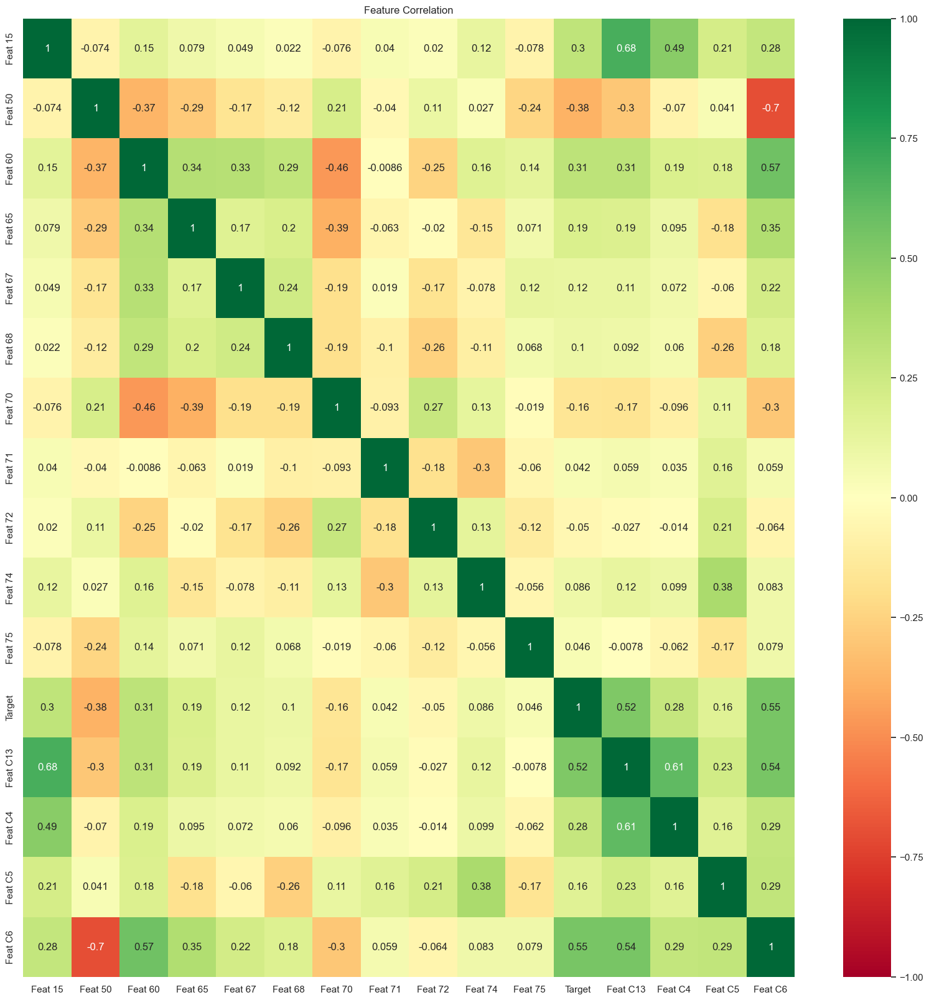

In [389]:
feat_corr(df_energy)

In [390]:
df_energy.describe().round(2)

,Feat 15,Feat 50,Feat 60,Feat 65,Feat 67,Feat 68,Feat 70,Feat 71,Feat 72,Feat 74,Feat 75,Target,Feat C13,Feat C4,Feat C5,Feat C6
count,70128.00,70128.00,70128.00,70128.00,70128.00,70128.00,70128.00,70128.00,70128.00,70128.00,70128.00,70128.00,70128.00,70128.00,70128.00,70128.00
mean,29.62,-11.94,567.49,168.50,76.70,-130.70,4190.01,110.65,259.98,3159.68,493.55,40.39,418.98,46.95,50663.88,42.23
std,58.05,22.48,87.41,70.83,63.42,102.88,954.36,510.72,32.81,656.13,413.91,67.40,568.67,108.12,10910.61,35.14
min,-1672.93,-385.14,364.00,33.00,0.00,-1279.00,1076.00,0.00,0.00,0.00,0.00,-1086.24,-8406.55,-6852.48,28764.00,0.30
25%,14.60,-14.34,500.00,112.00,29.00,-173.00,3306.00,0.00,244.00,2751.00,152.00,19.53,223.03,25.02,42940.00,23.55
50%,21.55,-3.36,566.00,185.00,62.00,-105.00,4340.00,2.00,261.00,3277.00,374.00,27.00,308.96,39.84,49306.50,31.38
75%,31.58,0.00,629.00,219.00,107.00,-61.00,5204.00,50.00,278.00,3640.00,756.25,41.10,457.31,58.05,55893.00,46.78
max,3906.41,27.63,903.00,557.00,558.00,0.00,5450.00,5430.00,479.00,5248.00,2140.00,4091.22,49345.56,6146.93,99742.00,535.42


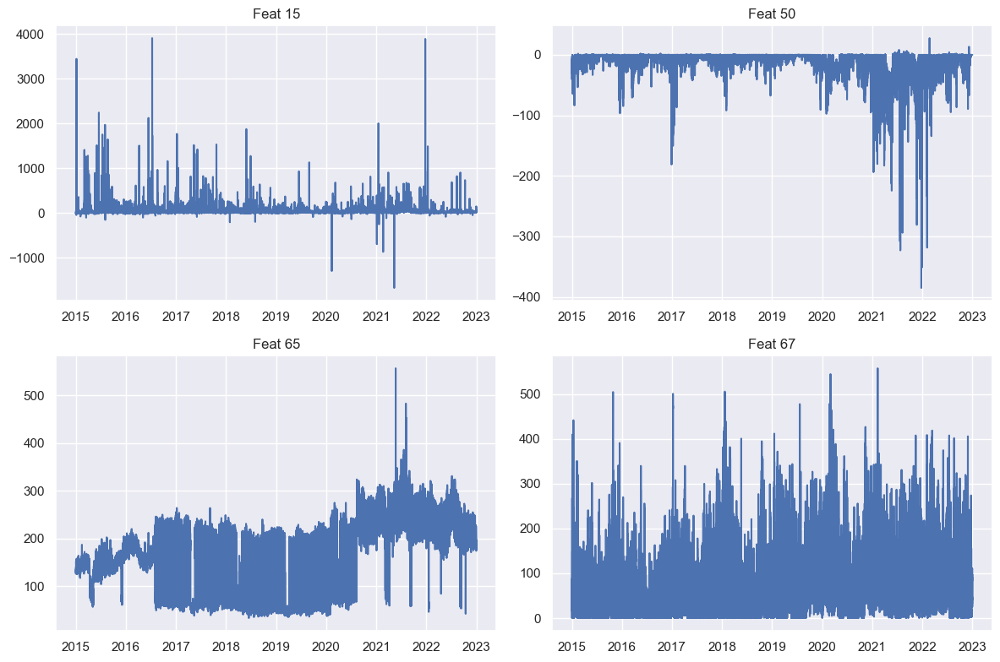

In [391]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12,8))

# select the columns to plot
columns_to_plot = ['Feat 15', 'Feat 50', 'Feat 65', 'Feat 67']

# loop through the subplots and plot each column
for i, ax in enumerate(axes.flat):
    if i < len(columns_to_plot):
        ax.plot(df_energy.index, df_energy[columns_to_plot[i]])
        ax.set_title(columns_to_plot[i])
    else:
        ax.set_visible(False)

plt.tight_layout()  # adjust the spacing between subplots
plt.show()

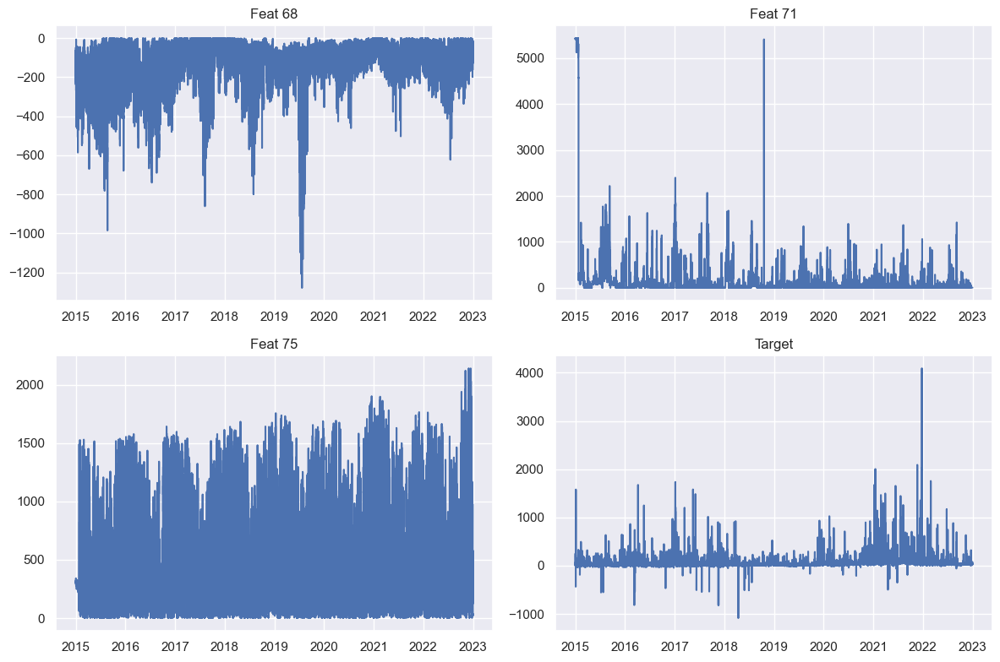

In [392]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12,8))

# select the columns to plot
columns_to_plot = ['Feat 68','Feat 71','Feat 75','Target']

# loop through the subplots and plot each column
for i, ax in enumerate(axes.flat):
    if i < len(columns_to_plot):
        ax.plot(df_energy.index, df_energy[columns_to_plot[i]])
        ax.set_title(columns_to_plot[i])
    else:
        ax.set_visible(False)

plt.tight_layout()  # adjust the spacing between subplots
plt.show()

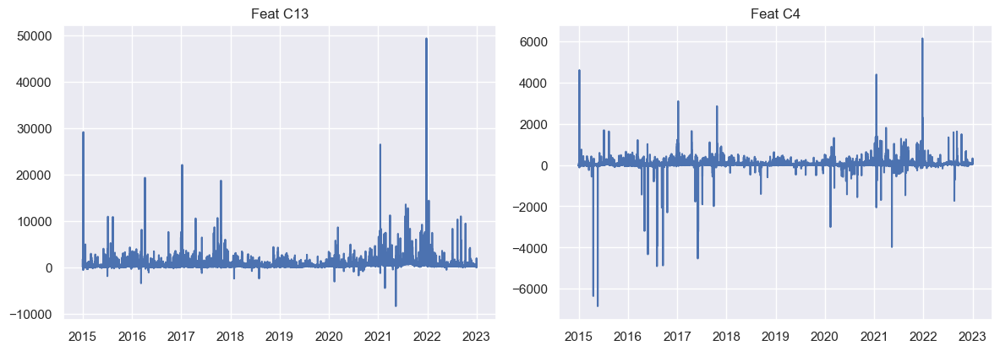

In [393]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12,8))

# select the columns to plot
columns_to_plot = ['Feat C13','Feat C4']

# loop through the subplots and plot each column
for i, ax in enumerate(axes.flat):
    if i < len(columns_to_plot):
        ax.plot(df_energy.index, df_energy[columns_to_plot[i]])
        ax.set_title(columns_to_plot[i])
    else:
        ax.set_visible(False)

plt.tight_layout()  # adjust the spacing between subplots
plt.show()

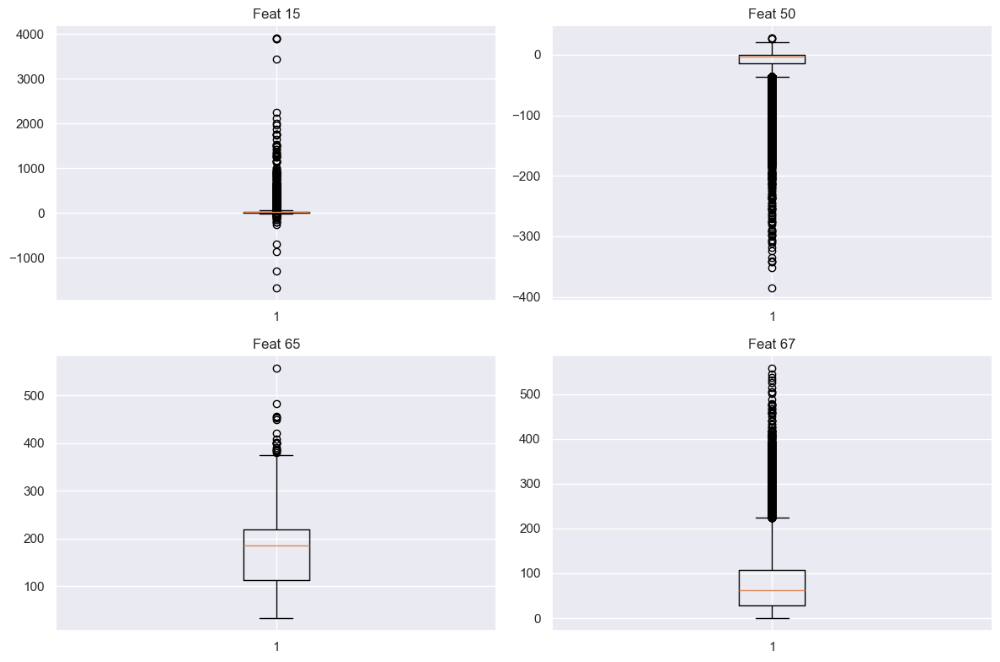

In [394]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12,8))

# select the columns to plot
columns_to_plot = ['Feat 15', 'Feat 50', 'Feat 65', 'Feat 67']

# loop through the subplots and plot each column
for i, ax in enumerate(axes.flat):
    if i < len(columns_to_plot):
        ax.boxplot(x = df_energy[columns_to_plot[i]])
        ax.set_title(columns_to_plot[i])
    else:
        ax.set_visible(False)

plt.tight_layout()  # adjust the spacing between subplots
plt.show()  # display the plot

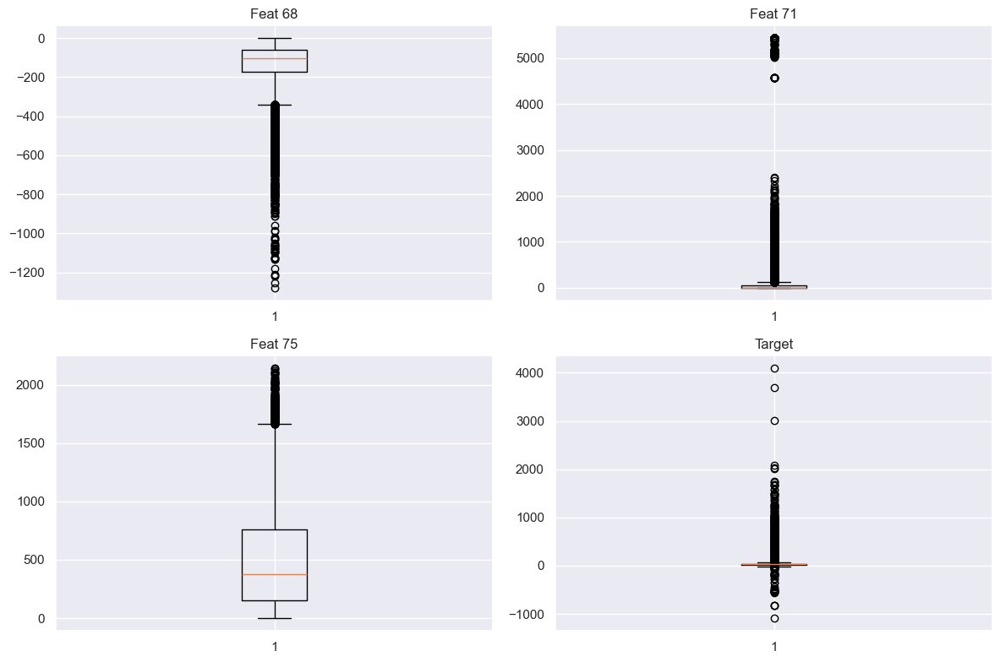

In [395]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12,8))

# select the columns to plot
columns_to_plot = ['Feat 68','Feat 71','Feat 75','Target']

# loop through the subplots and plot each column
for i, ax in enumerate(axes.flat):
    if i < len(columns_to_plot):
        ax.boxplot(x = df_energy[columns_to_plot[i]])
        ax.set_title(columns_to_plot[i])
    else:
        ax.set_visible(False)

plt.tight_layout()  # adjust the spacing between subplots
plt.show()  # display the plot

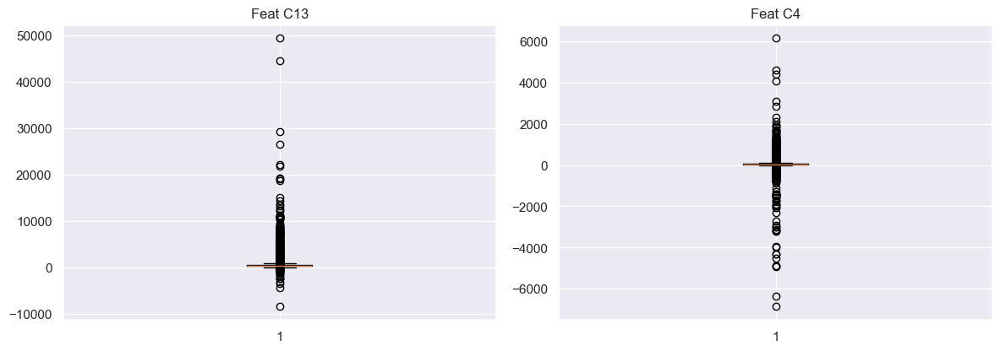

In [396]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12,8))

# select the columns to plot
columns_to_plot = ['Feat C13','Feat C4']
# loop through the subplots and plot each column
for i, ax in enumerate(axes.flat):
    if i < len(columns_to_plot):
        ax.boxplot(x = df_energy[columns_to_plot[i]])
        ax.set_title(columns_to_plot[i])
    else:
        ax.set_visible(False)

plt.tight_layout()  # adjust the spacing between subplots
plt.show()  # display the plot

In [397]:
def replace_outliers_pauta(data, method='mean'):
    # Calculate mean and std for each column
    mean = data.mean()
    std = data.std()

    # Define the upper and lower bounds for outliers
    lower_bound = mean - 1.5 * std
    upper_bound = mean + 1.5 * std

    # Find the outliers (values outside the bounds)
    outliers = (data < lower_bound) | (data > upper_bound)

    # Define the replacement value (mean or median)
    if method == 'mean':
        replacement_value = mean
    else:
        replacement_value = data.median()

    # Replace outliers with the replacement value for each column
    for column in data.columns:
        data.loc[outliers[column], column] = replacement_value[column] if isinstance(replacement_value, pd.Series) else replacement_value

    return data


In [398]:
df_energy = replace_outliers_pauta(df_energy, method='median')

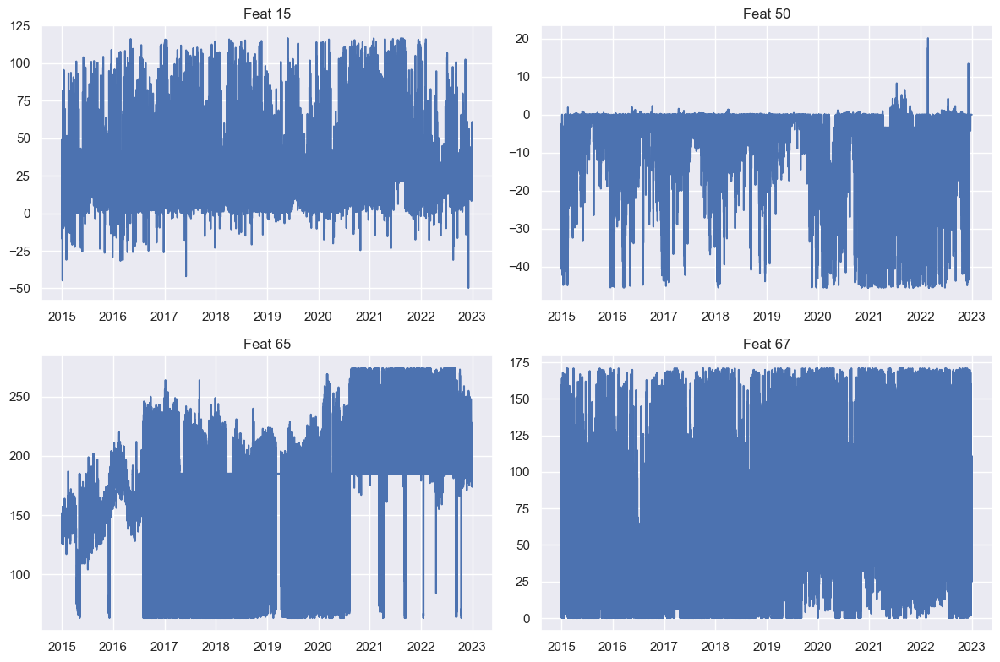

In [399]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12,8))

# select the columns to plot
columns_to_plot = ['Feat 15', 'Feat 50', 'Feat 65', 'Feat 67']

# loop through the subplots and plot each column
for i, ax in enumerate(axes.flat):
    if i < len(columns_to_plot):
        ax.plot(df_energy.index, df_energy[columns_to_plot[i]])
        ax.set_title(columns_to_plot[i])
    else:
        ax.set_visible(False)

plt.tight_layout()  # adjust the spacing between subplots
plt.show()

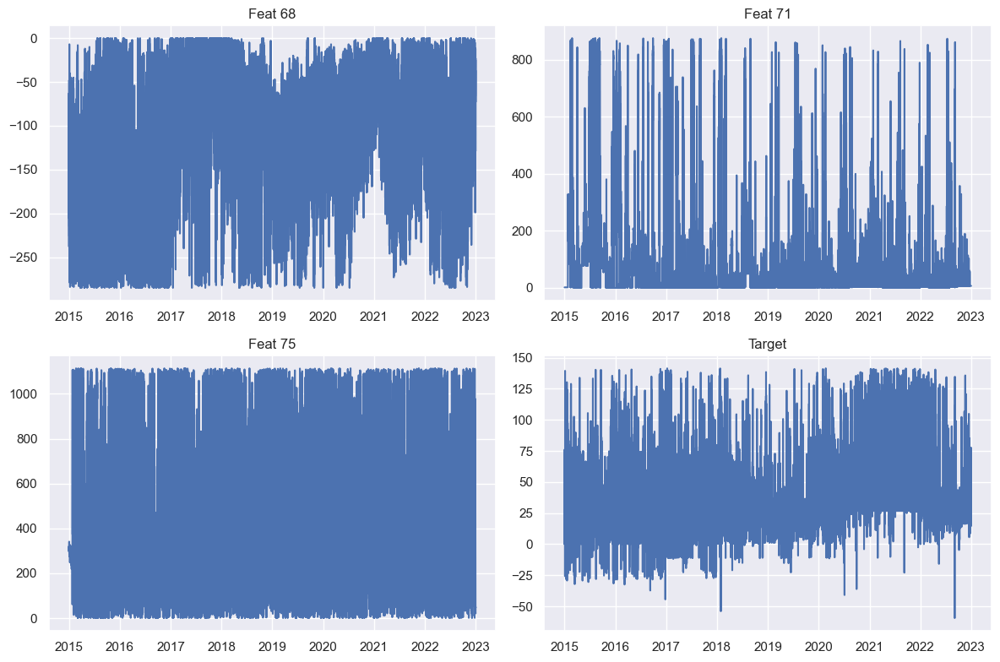

In [400]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12,8))

# select the columns to plot
columns_to_plot = ['Feat 68','Feat 71','Feat 75','Target']

# loop through the subplots and plot each column
for i, ax in enumerate(axes.flat):
    if i < len(columns_to_plot):
        ax.plot(df_energy.index, df_energy[columns_to_plot[i]])
        ax.set_title(columns_to_plot[i])
    else:
        ax.set_visible(False)

plt.tight_layout()  # adjust the spacing between subplots
plt.show()

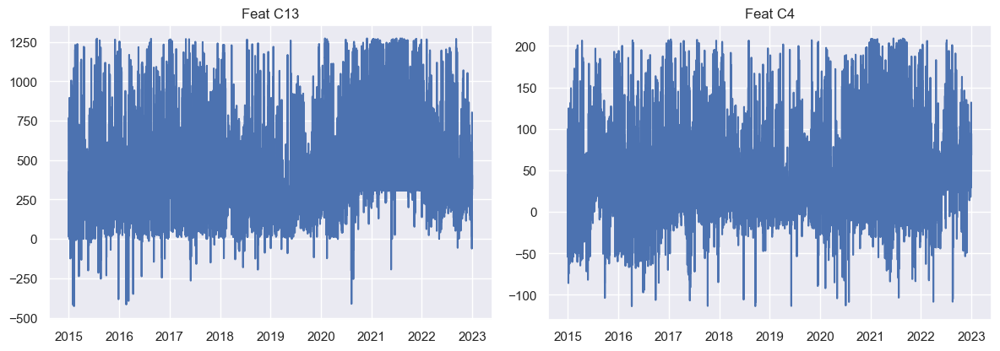

In [401]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12,8))

# select the columns to plot
columns_to_plot = ['Feat C13','Feat C4']

# loop through the subplots and plot each column
for i, ax in enumerate(axes.flat):
    if i < len(columns_to_plot):
        ax.plot(df_energy.index, df_energy[columns_to_plot[i]])
        ax.set_title(columns_to_plot[i])
    else:
        ax.set_visible(False)

plt.tight_layout()  # adjust the spacing between subplots
plt.show()

In [402]:
df_weather_energy = df_energy

In [403]:
df_weather_energy.columns


Index(['Feat 15', 'Feat 50', 'Feat 60', 'Feat 65', 'Feat 67', 'Feat 68',
       'Feat 70', 'Feat 71', 'Feat 72', 'Feat 74', 'Feat 75', 'Target',
       'Feat C13', 'Feat C4', 'Feat C5', 'Feat C6'],
      dtype='object')

In [404]:
check_Nans_Dups(df_weather_energy)


Number of Nans in each column :
Feat 15     0
Feat 50     0
Feat 60     0
Feat 65     0
Feat 67     0
Feat 68     0
Feat 70     0
Feat 71     0
Feat 72     0
Feat 74     0
Feat 75     0
Target      0
Feat C13    0
Feat C4     0
Feat C5     0
Feat C6     0
dtype: int64

Number of duplicates in the dataframe : 0


In [405]:
df_weather_energy['hour'] = df_weather_energy.index.map(lambda x : x.hour)
df_weather_energy['weekday'] = df_weather_energy.index.map(lambda x : x.weekday())
df_weather_energy['month'] = df_weather_energy.index.map(lambda x : x.month)
df_weather_energy['year'] = df_weather_energy.index.map(lambda x: x.year)

In [406]:
df_weather_energy.columns

Index(['Feat 15', 'Feat 50', 'Feat 60', 'Feat 65', 'Feat 67', 'Feat 68',
       'Feat 70', 'Feat 71', 'Feat 72', 'Feat 74', 'Feat 75', 'Target',
       'Feat C13', 'Feat C4', 'Feat C5', 'Feat C6', 'hour', 'weekday', 'month',
       'year'],
      dtype='object')

In [407]:
fig = make_subplots()

fig.add_trace(
    go.Line(x=df_weather_energy.index, y=df_weather_energy["Target"],
                                name="Target"))
fig.add_trace(
    go.Line(x=df_weather_energy.index,y=df_weather_energy.rolling(window=24).mean()["Target"],
                                        name="rolling window = daily ave"))
fig.add_trace(
    go.Line(x=df_weather_energy.index,y=df_weather_energy.rolling(window=24*7).mean()["Target"],
                                        name="rolling window = weekly ave"))
# fig.update_xaxes(rangeslider_visible=True)
fig.show()

/home/dxr5576/anaconda3/envs/TNE/lib/python3.9/site-packages/plotly/graph_objs/_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




Text(0.5, 1.0, 'Daily actual price (0 is Monday)')

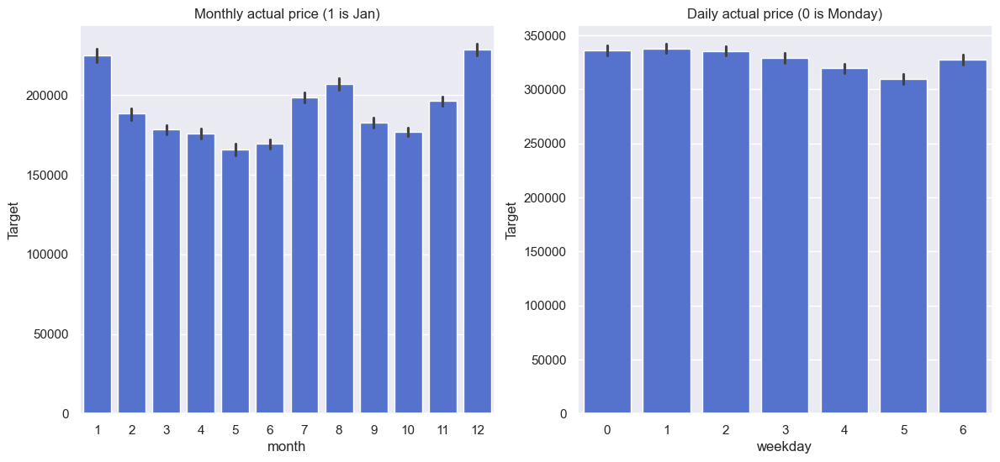

In [408]:
fig, axes = plt.subplots(ncols=2, figsize=(14, 6))
sns.set(style="darkgrid")

sns.barplot(
    x="month", 
    y="Target", 
    data=df_weather_energy, 
    estimator=sum, 
    color='royalblue',
    ax=axes[0]);
axes[0].set_title('Monthly actual price (1 is Jan)')

sns.barplot(
    x="weekday", 
    y="Target", 
    data=df_weather_energy, 
    estimator=sum, 
    color='royalblue',
    ax=axes[1]);
axes[1].set_title('Daily actual price (0 is Monday)')

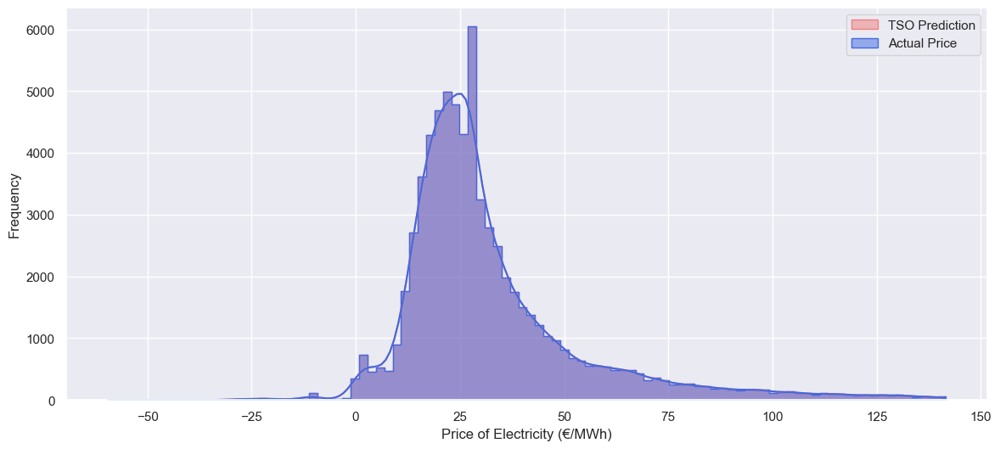

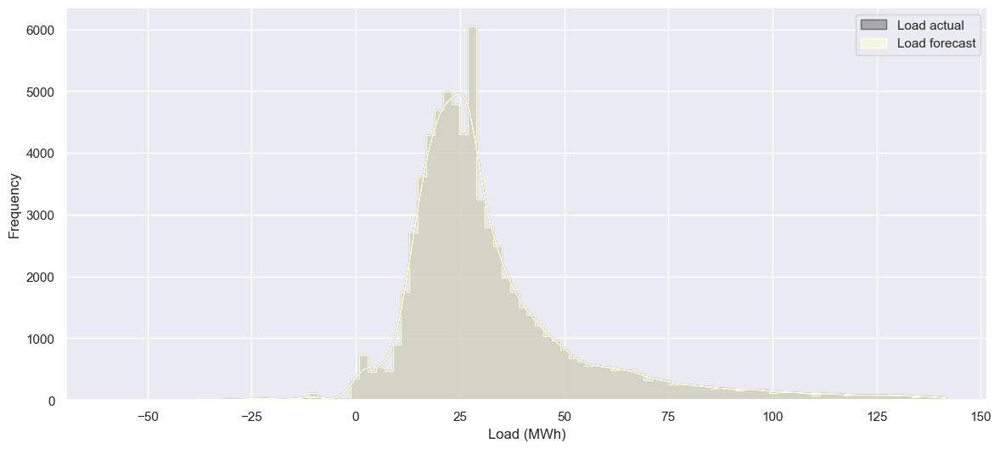

In [409]:
plt.figure(figsize=(14,6))

gr = sns.histplot(df_weather_energy['Target'], bins=100, label='TSO Prediction', element="step", color='lightcoral', kde = True)
gr = sns.histplot(df_weather_energy['Target'], bins=100, label='Actual Price', element="step", color='royalblue', kde = True)


gr.set(xlabel="Price of Electricity (€/MWh)", ylabel="Frequency")
plt.legend()
plt.show()

plt.figure(figsize=(14,6))
gr = sns.histplot(df_weather_energy['Target'], bins=100, label='Load actual', element="step", color='dimgrey', kde = True)
gr = sns.histplot(df_weather_energy['Target'], bins=100, label='Load forecast', element="step", color='lightyellow', kde = True)

gr.set(xlabel="Load (MWh)", ylabel="Frequency")
plt.legend()
plt.show()

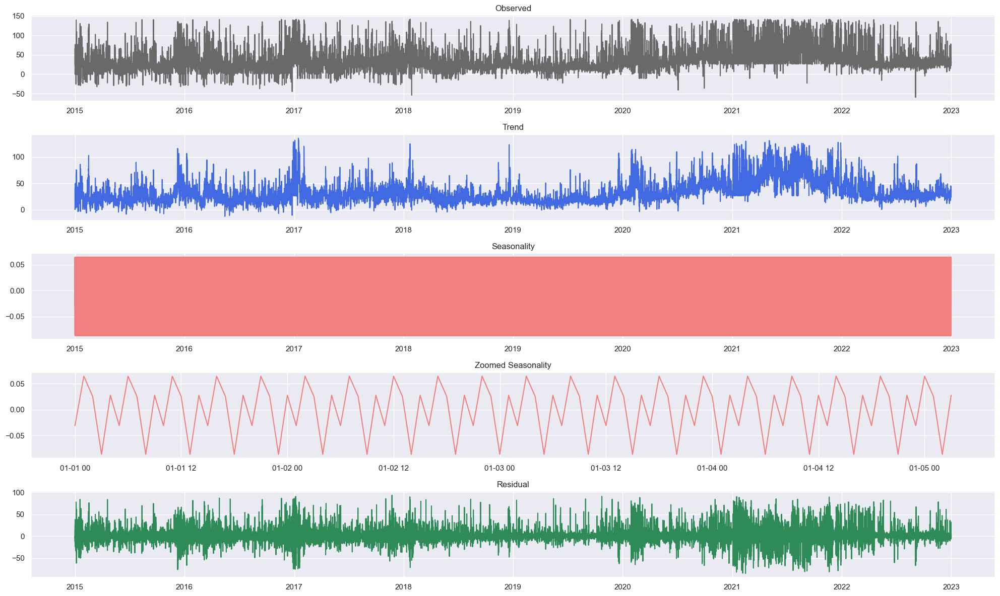

In [410]:
fig, axes = plt.subplots(5, 1, figsize=(20, 12))
decom_data = df_weather_energy[['Target']].copy()

decompose_result = seasonal_decompose(decom_data, period =5, model='additive')

observed    = decompose_result.observed
trend    = decompose_result.trend
seasonal = decompose_result.seasonal
residual = decompose_result.resid

axes[0].plot(observed, color='dimgrey')
axes[0].set_title('Observed')
axes[1].plot(trend, color='royalblue')
axes[1].set_title('Trend')
axes[2].plot(seasonal, color='lightcoral')
axes[2].set_title('Seasonality')
axes[3].plot(seasonal[:100], color='lightcoral')
axes[3].set_title('Zoomed Seasonality')
axes[4].plot(residual, color='seagreen')
axes[4].set_title('Residual')

fig.tight_layout()
plt.show()

In [411]:
result = adfuller(df_weather_energy[['Target']])
print('ADF Statistic:', result[0])
print('p-value:', result[1])
print('Critical Values:', result[4])

ADF Statistic: -11.868409955609167
p-value: 6.59123982619833e-22
Critical Values: {'1%': -3.430443323337656, '5%': -2.8615812472590405, '10%': -2.5667919545064675}


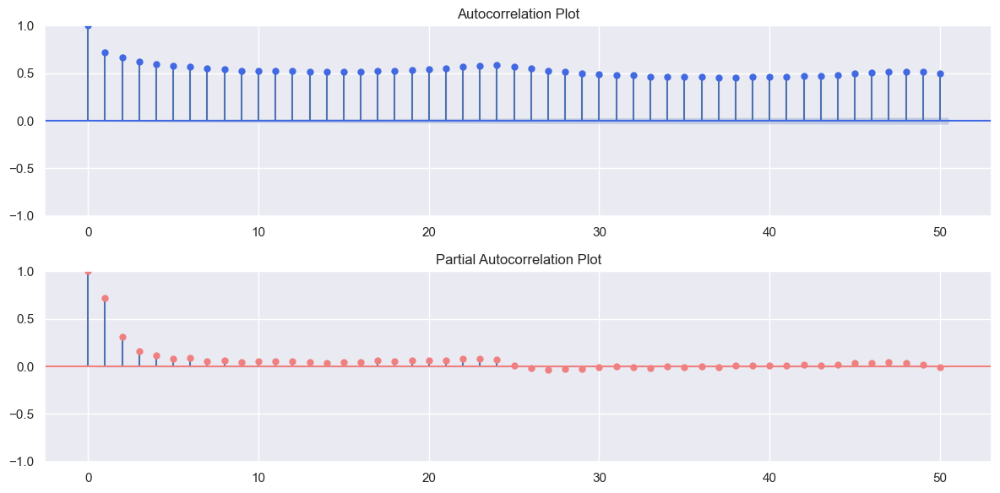

In [412]:
fig, ax = plt.subplots(2, 1, figsize=(12, 6))
plot_acf(df_weather_energy['Target'], lags=50, ax=ax[0], color='royalblue')
ax[0].set_title('Autocorrelation Plot')
plot_pacf(df_weather_energy['Target'], lags=50, ax=ax[1], color='lightcoral')
ax[1].set_title('Partial Autocorrelation Plot')
plt.tight_layout()
plt.show()

In [413]:
X = df_weather_energy.drop(['Target'], axis = 1)
y= df_weather_energy[['Target']]

In [414]:
def apply_PCA(X_input, cum_variance, if_apply):
    
    if if_apply:
    
        pca = PCA(n_components = cum_variance)
        # make pipeline to first standardize then apply PCA on data
        scaler_pca = make_pipeline(MinMaxScaler(), pca)
        X_pca = scaler_pca.fit(X_input).transform(X_input)

        return X_pca
    
    else:
        
        return np.array(X_input)

In [415]:
params_pca = {'cum_variance' : 0.95, 'if_apply' : True }
X_pca = apply_PCA(X, **params_pca)
X_pca.shape

(70128, 15)

In [416]:
def windowing(X_input,y_input, history_size):
    
    data = []
    labels = []
    for i in range(history_size, len(y_input)):
        data.append(X_input[i - history_size : i, :])
        labels.append(y_input[i])
        
    return np.array(data), np.array(labels).reshape(-1,1)

In [417]:
train_cutoff = int(0.8*X_pca.shape[0])
val_cutoff   = int(0.9*X_pca.shape[0])

scaler_y = MinMaxScaler()
scaler_y.fit(y[:train_cutoff])
y_norm = scaler_y.transform(y)

In [443]:
hist_size= 24
data_norm = np.concatenate((X_pca,y_norm), axis = 1)

X_train, y_train = windowing(data_norm[:train_cutoff,:],data_norm[:train_cutoff,-1], hist_size)
X_val, y_val     = windowing(data_norm[train_cutoff :val_cutoff,:],data_norm[train_cutoff:val_cutoff,-1], hist_size)
X_test, y_test   = windowing(data_norm[val_cutoff :,:],data_norm[val_cutoff:,-1], hist_size)

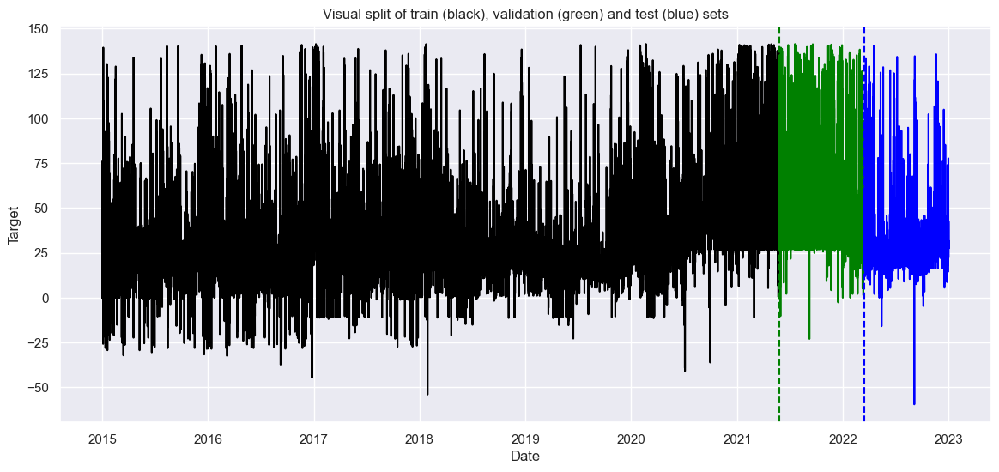

In [419]:
fig, axes = plt.subplots(figsize = (14,6))
axes.plot(df_weather_energy['Target'].iloc[:train_cutoff], color = 'black')
axes.plot(df_weather_energy['Target'].iloc[train_cutoff + 1 : val_cutoff], color = 'green')
axes.plot(df_weather_energy['Target'].iloc[val_cutoff + 1 :], color = 'blue')
axes.axvline(x=df_weather_energy.index[train_cutoff], color='green', linestyle='--')
axes.axvline(x=df_weather_energy.index[val_cutoff], color='blue', linestyle='--')
axes.set_title('Visual split of train (black), validation (green) and test (blue) sets')
axes.set_xlabel('Date')
axes.set_ylabel('Target')
plt.show()

In [420]:
# inputs for DL models
epoch = 100
batch_size = 64
steps_per_epoch = len(X_train) // batch_size
cyclic_lr = tfa.optimizers.CyclicalLearningRate(initial_learning_rate=1e-03,
                                                maximal_learning_rate=1e-01,
                                                scale_fn=lambda x: 1/(2**(x-1)),
                                                step_size=6 * steps_per_epoch)

callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=8)
optimizer = Adam(learning_rate=cyclic_lr, amsgrad=True)

In [421]:
def plot_results(y_pred_actual, y_test_inv, model, model_name):
    fig, ax = plt.subplots(2, 1, figsize=(12, 6))
    
    ax[0].plot(y_pred_actual[:1000])
    ax[0].plot(y_test_inv[:1000])
    ax[0].legend(['prediction', 'actual'], loc='upper left')
    ax[0].set_title(f'Prediction vs actual price for 1000 observation in test set ({model_name})')
    ax[0].set_xlabel('Observation')
    ax[0].set_ylabel('Price')
    
    if model != 'hybrid':
    
        if model_name == 'XGBoost':

            train_mae = model.evals_result()['validation_0']['mae']
            val_mae = model.evals_result()['validation_1']['mae']
            ax[1].plot(train_mae, label='Training MAE')
            ax[1].plot(val_mae, label='Validation MAE')

        else:

            ax[1].plot(history.history['loss'], label='Training Loss')
            ax[1].plot(history.history['val_loss'], label='Validation Loss')

        ax[1].legend()
        ax[1].set_title(f'Training and validation MAE ({model_name})')
        ax[1].set_xlabel('Iteration/Epochs')
        ax[1].set_ylabel('MAE')    
        
    fig.tight_layout()
    plt.show()

In [422]:
def base_model_lstm():

    model = Sequential()
    model.add(LSTM(units = 32, return_sequences = True, activation="relu", input_shape = X_train.shape[-2:]))
    model.add(Flatten())
    model.add(Dense(units=128, activation='relu'))
    model.add(Dropout(0.1))
    model.add(Dense(1))
    
    return model

lstm_model = base_model_lstm()
lstm_model.compile(optimizer = optimizer , loss = 'mean_absolute_error')
lstm_model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (None, 24, 32)            6272      
                                                                 
 flatten_9 (Flatten)         (None, 768)               0         
                                                                 
 dense_18 (Dense)            (None, 128)               98432     
                                                                 
 dropout_6 (Dropout)         (None, 128)               0         
                                                                 
 dense_19 (Dense)            (None, 1)                 129       
                                                                 
Total params: 104833 (409.50 KB)
Trainable params: 104833 (409.50 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [423]:
history = lstm_model.fit(X_train, y_train, validation_data = (X_val, y_val), epochs =epoch, 
                   batch_size = batch_size, callbacks=[callback])

Epoch 1/100
877/877 [==============================] - 11s 12ms/step - loss: 0.0511 - val_loss: 0.0791
Epoch 2/100
877/877 [==============================] - 10s 12ms/step - loss: 0.0436 - val_loss: 0.0820
Epoch 3/100
877/877 [==============================] - 10s 11ms/step - loss: 0.0443 - val_loss: 0.0760
Epoch 4/100
877/877 [==============================] - 10s 11ms/step - loss: 0.0445 - val_loss: 0.0688
Epoch 5/100
877/877 [==============================] - 10s 11ms/step - loss: 0.0451 - val_loss: 0.0841
Epoch 6/100
877/877 [==============================] - 10s 11ms/step - loss: 0.0455 - val_loss: 0.0885
Epoch 7/100
877/877 [==============================] - 10s 11ms/step - loss: 0.0455 - val_loss: 0.1001
Epoch 8/100
877/877 [==============================] - 10s 11ms/step - loss: 0.0433 - val_loss: 0.0722
Epoch 9/100
877/877 [==============================] - 10s 11ms/step - loss: 0.0423 - val_loss: 0.0699
Epoch 10/100
877/877 [==============================] - 10s 11ms/step - l

In [424]:
y_pred = lstm_model.predict(X_test)


219/219 [==============================] - 1s 3ms/step




---------------------------------------------------
LSTM MAE for test set : 0.026
---------------------------------------------------



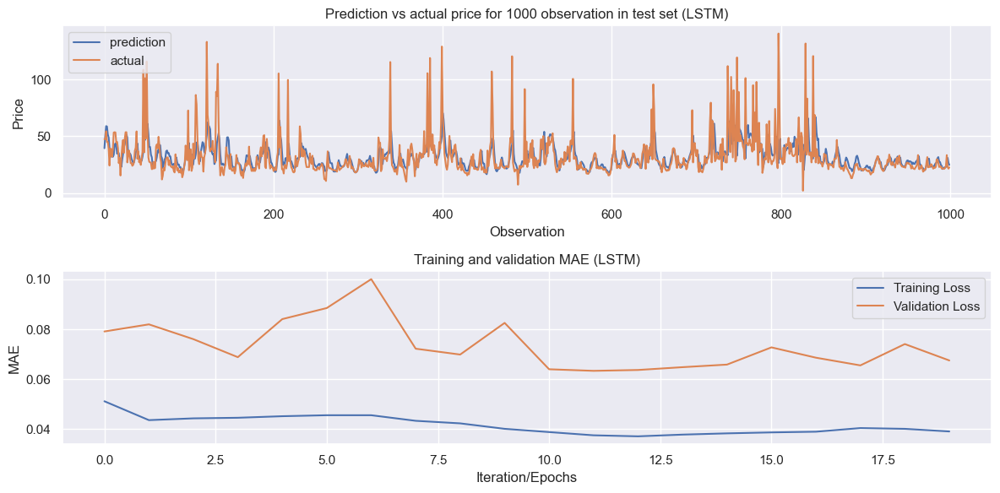

In [425]:
y_pred_actual = scaler_y.inverse_transform(y_pred.reshape(-1,1))
y_test_inv = scaler_y.inverse_transform(y_test)
print('')
print('')
y_pred_actual = scaler_y.inverse_transform(y_pred.reshape(-1,1))
y_test_inv = scaler_y.inverse_transform(y_test)
print('---------------------------------------------------')
print(f'LSTM MAE for test set : {round(mean_absolute_error(y_pred,y_test),3)}')
print('---------------------------------------------------')
y_pred_actual = scaler_y.inverse_transform(y_pred)
print('')
plot_results( y_pred_actual,y_test_inv, history,'LSTM')

In [426]:
def MAPE(Y_actual,Y_Predicted):
    mape = np.mean(np.abs((Y_actual - Y_Predicted)/Y_actual))*100
    return mape

In [427]:
mape= MAPE(y_pred_actual, y_test_inv)
print('Mean Absolute percentage Error:', mape)

Mean Absolute percentage Error: 16.240482454300913


In [428]:
def LSTM_attention():
    inputs = Input(shape=(hist_size, X_train.shape[2]))
    #By masking the zeros, the model can learn to ignore the missing values and focus on the valid data.
    masked = Masking(mask_value=0.)(inputs)
    lstm = LSTM(132, return_sequences=True)(masked)
    attention = dot([lstm, lstm], axes=[2, 2])
    # extracting weight for every observation in the history size!
    attention = Dense(hist_size, activation='softmax')(attention)
    # assinging weight to lstm by dot product
    context = dot([attention, lstm], axes=[2, 1])
    flattened = Flatten()(context)
    output = Dense(1)(flattened)
    model = Model(inputs=inputs, outputs=output)
    
    return model

LSTM_attention_model = LSTM_attention()
LSTM_attention_model.compile(optimizer=optimizer, loss='mae')
LSTM_attention_model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 24, 16)]             0         []                            
                                                                                                  
 masking_3 (Masking)         (None, 24, 16)               0         ['input_4[0][0]']             
                                                                                                  
 lstm_9 (LSTM)               (None, 24, 132)              78672     ['masking_3[0][0]']           
                                                                                                  
 dot_6 (Dot)                 (None, 24, 24)               0         ['lstm_9[0][0]',              
                                                                     'lstm_9[0][0]']        

In [429]:
from tensorflow.keras.optimizers import legacy
optimizer = legacy.Adam()
LSTM_attention_model.compile(optimizer=optimizer, loss='mse')

In [430]:
history = LSTM_attention_model.fit(X_train, y_train, epochs=epoch, batch_size=batch_size,
                    validation_data=(X_val, y_val),
                    callbacks=[callback])

Epoch 1/100
877/877 [==============================] - 6s 4ms/step - loss: 0.0066 - val_loss: 0.0110
Epoch 2/100
877/877 [==============================] - 3s 3ms/step - loss: 0.0051 - val_loss: 0.0106
Epoch 3/100
877/877 [==============================] - 3s 3ms/step - loss: 0.0050 - val_loss: 0.0109
Epoch 4/100
877/877 [==============================] - 3s 3ms/step - loss: 0.0049 - val_loss: 0.0104
Epoch 5/100
877/877 [==============================] - 3s 3ms/step - loss: 0.0049 - val_loss: 0.0105
Epoch 6/100
877/877 [==============================] - 3s 3ms/step - loss: 0.0048 - val_loss: 0.0101
Epoch 7/100
877/877 [==============================] - 3s 3ms/step - loss: 0.0047 - val_loss: 0.0100
Epoch 8/100
877/877 [==============================] - 3s 3ms/step - loss: 0.0048 - val_loss: 0.0106
Epoch 9/100
877/877 [==============================] - 3s 3ms/step - loss: 0.0047 - val_loss: 0.0103
Epoch 10/100
877/877 [==============================] - 3s 3ms/step - loss: 0.0047 - val_lo

219/219 [==============================] - 1s 2ms/step


---------------------------------------------------
LSTM-Attention MAE for test set : 5.04
---------------------------------------------------



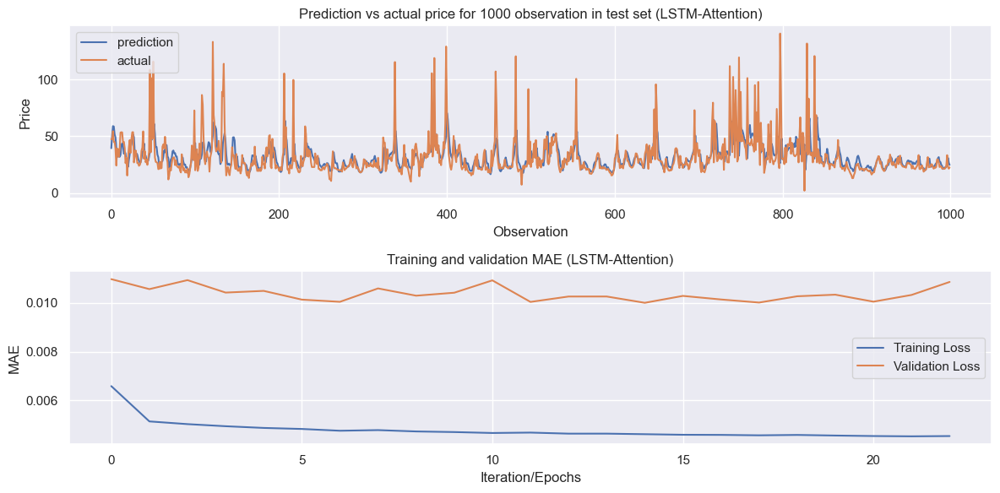

In [431]:
y_pred1 = LSTM_attention_model.predict(X_test)
print('')
print('')

print('---------------------------------------------------')
print(f'LSTM-Attention MAE for test set : {round(mean_absolute_error(y_pred_actual, y_test_inv),3)}')
print('---------------------------------------------------')
y_pred_actual1 = scaler_y.inverse_transform(y_pred1)
print('')
plot_results(y_pred_actual,y_test_inv,  history,'LSTM-Attention')

In [432]:
mape= MAPE(y_pred_actual1, y_test_inv)
print('Mean Absolute percentage Error:', mape)

Mean Absolute percentage Error: 21.51521489489896


In [445]:
from keras.regularizers import l1, l2
epoch = 30
batch_size = 64
steps_per_epoch = len(X_train) // batch_size
cyclic_lr = tfa.optimizers.CyclicalLearningRate(initial_learning_rate=1e-04,
                                                maximal_learning_rate=1e-02,
                                                scale_fn=lambda x: 1/(2**(x-1)),
                                                step_size=6 * steps_per_epoch)

callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True)
optimizer = Adam(learning_rate=cyclic_lr, amsgrad=True)
def base_model_lstm():

    model = Sequential()
    model.add(LSTM(units = 128, return_sequences = True, activation="relu", input_shape = (24, 16),  recurrent_dropout=0.2, kernel_regularizer=l2(0.01), recurrent_regularizer=l2(0.01)))
    model.add(Flatten())
    model.add(Dense(units=128, activation='relu'))
    model.add(Dropout(0.1))
    model.add(Dense(1))

    return model

lstm_model = base_model_lstm()
lstm_model.compile(optimizer = optimizer , loss = 'mean_absolute_error')
lstm_model.summary()

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_12 (LSTM)              (None, 24, 128)           74240     
                                                                 
 flatten_13 (Flatten)        (None, 3072)              0         
                                                                 
 dense_26 (Dense)            (None, 128)               393344    
                                                                 
 dropout_9 (Dropout)         (None, 128)               0         
                                                                 
 dense_27 (Dense)            (None, 1)                 129       
                                                                 
Total params: 467713 (1.78 MB)
Trainable params: 467713 (1.78 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [446]:
history = lstm_model.fit(X_train, y_train, validation_data = (X_val, y_val), epochs =epoch,
                   batch_size = batch_size, callbacks=[callback])

Epoch 1/30
877/877 [==============================] - 24s 26ms/step - loss: 0.2798 - val_loss: 0.0884
Epoch 2/30
877/877 [==============================] - 22s 25ms/step - loss: 0.0463 - val_loss: 0.0889
Epoch 3/30
877/877 [==============================] - 22s 25ms/step - loss: 0.0449 - val_loss: 0.0747
Epoch 4/30
877/877 [==============================] - 23s 26ms/step - loss: 0.0436 - val_loss: 0.0726
Epoch 5/30
877/877 [==============================] - 23s 26ms/step - loss: 0.0433 - val_loss: 0.0703
Epoch 6/30
877/877 [==============================] - 23s 26ms/step - loss: 0.0434 - val_loss: 0.0692
Epoch 7/30
877/877 [==============================] - 22s 25ms/step - loss: 0.0425 - val_loss: 0.0785
Epoch 8/30
877/877 [==============================] - 22s 25ms/step - loss: 0.0419 - val_loss: 0.0684
Epoch 9/30
877/877 [==============================] - 22s 25ms/step - loss: 0.0411 - val_loss: 0.0696
Epoch 10/30
877/877 [==============================] - 22s 25ms/step - loss: 0.040

219/219 [==============================] - 1s 6ms/step


---------------------------------------------------
LSTM-Attention MAE for test set : 5.04
---------------------------------------------------



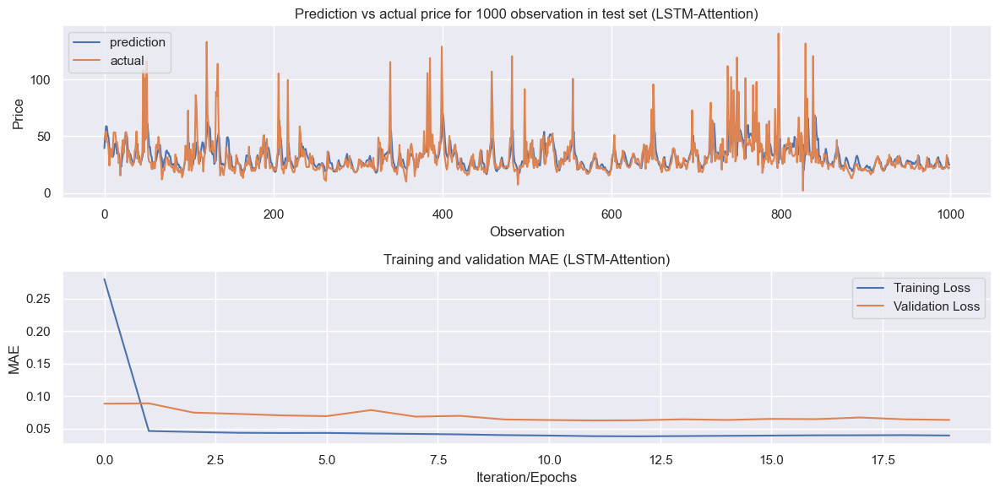

In [447]:
y_pred1 = lstm_model.predict(X_test)
print('')
print('')

print('---------------------------------------------------')
print(f'LSTM-Attention MAE for test set : {round(mean_absolute_error(y_pred_actual, y_test_inv),3)}')
print('---------------------------------------------------')
y_pred_actual1 = scaler_y.inverse_transform(y_pred1)
print('')
plot_results(y_pred_actual,y_test_inv,  history,'LSTM-Attention')

In [ ]:
mape= MAPE(y_pred_actual1, y_test_inv)
print('Mean Absolute percentage Error:', mape)